In [14]:
import pandas as pd
import numpy as np
import csv
import urllib.request
import zipfile
import random
import itertools
import math
import shapefile
import dask.dataframe as dd

In [27]:
import shapefile as shp
import matplotlib as mpl
import matplotlib.pyplot as plt
plt.style.use('ggplot')
%matplotlib inline

In [28]:
import geopandas as gpd
import folium
import folium.plugins
folium.plugins.MarkerCluster()
from folium.plugins import FastMarkerCluster
import time
import datetime
from sklearn.cluster import MiniBatchKMeans, KMeans

In [29]:
#reading data
month_10 = dd.read_csv("yellow_tripdata_2015-10.csv")
month_11 = dd.read_csv("yellow_tripdata_2015-11.csv")
month = dd.read_csv("yellow_tripdata_2015-12.csv")

In [30]:
month_10_p = pd.read_csv("yellow_tripdata_2015-10.csv")
month_11_p = pd.read_csv("yellow_tripdata_2015-11.csv")
month_p = pd.read_csv("yellow_tripdata_2015-12.csv")

In [31]:
#removing outliers
outlier_locations = month_p[((month_p.pickup_longitude <= -74.257159) | (month_p.pickup_latitude <= 40.495992) | (month_p.pickup_longitude >= -73.699215) | (month_p.pickup_latitude >= 40.915568))]
month_p = month_p[~month_p.isin(outlier_locations)].dropna()
month_p = month_p.reset_index()
outlier_locations = month_p[((month_p.dropoff_longitude <= -74.257159) | (month_p.dropoff_latitude <= 40.495992) | (month_p.dropoff_longitude >= -73.699215) | (month_p.dropoff_latitude >= 40.915568))]
month_p = month_p[~month_p.isin(outlier_locations)].dropna()
month_p = month_p.reset_index()

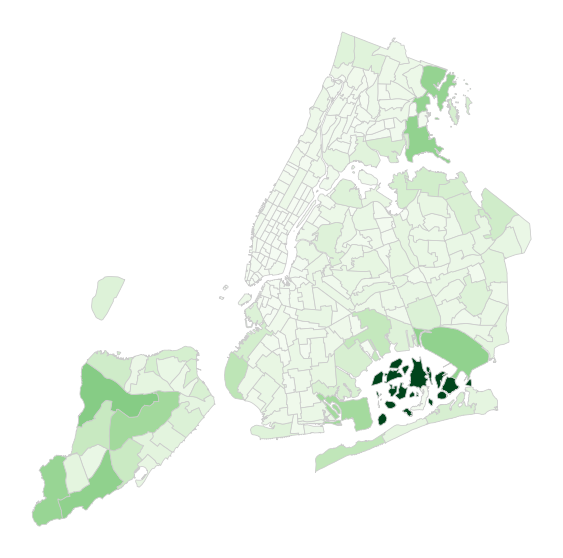

In [32]:
#showing taxi zones of nyc
nyc = gpd.read_file("shape/taxi_zones.shp")
variable = "Shape_Area"
vmin, vmax = 0, 50
fig, ax = plt.subplots(1, figsize=(30, 10))
ax.axis('off')
nyc.plot(column=variable, cmap='Greens', linewidth=0.8, ax=ax, edgecolor='0.8')

In [17]:
#pickup location
m = folium.Map(location=[40.767937,-73.982155 ],tiles='Stamen Terrain',
 zoom_start=12)
for each in month_p.sample(n=10000).iterrows():
    folium.CircleMarker([each[1]['pickup_latitude'],each[1]['pickup_longitude']],
                        radius=3,
                        color='blue',
                        popup=str(each[1]['pickup_latitude'])+','+str(each[1]['pickup_longitude']),
                        fill_color='blue'
                        ).add_to(m)
m

In [18]:
#dropoff location
m = folium.Map(location=[40.767937,-73.982155 ],tiles='Stamen Terrain',
 zoom_start=12)
for each in month_p.sample(n=10000).iterrows():
    folium.CircleMarker([each[1]['dropoff_latitude'],each[1]['dropoff_longitude']],
                        radius=3,
                        color='blue',
                        popup=str(each[1]['dropoff_latitude'])+','+str(each[1]['dropoff_longitude']),
                        fill_color='#red'
                        ).add_to(m)
m

[]

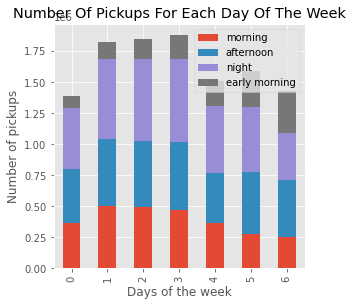

In [33]:
#finding number of pickups for each day of the week divided into timeslots
hour = month[['tpep_pickup_datetime','tpep_dropoff_datetime']].compute()
hour['tpep_pickup_datetime'] = pd.to_datetime(hour['tpep_pickup_datetime'])
hour["p_day"] = hour['tpep_pickup_datetime'].dt.strftime('%u').astype(int)
hour["p_hour"] = hour['tpep_pickup_datetime'].dt.strftime('%H').astype(int)
set(hour['p_day'].values)
day = []
afternoon = []
night = []
early = []
#day is [6,12), afternoon is [12,18), night is [18, 23), early morning is [23, 6)
for i in range(1,8):
    day.append(hour[(hour.p_day == i) & (hour.p_hour >= 6) & (hour.p_hour < 12)].shape[0])
    afternoon.append(hour[(hour.p_day == i) & (hour.p_hour >= 12) & (hour.p_hour < 18)].shape[0])
    night.append(hour[(hour.p_day == i) & (hour.p_hour >= 18) & (hour.p_hour <= 23)].shape[0])
    early.append(hour[(hour.p_day == i) & (hour.p_hour >= 0) & (hour.p_hour < 6)].shape[0])

days =pd.DataFrame({'morning':day, 'afternoon':afternoon, 'night':night, 'early morning':early})
days.plot(kind='bar', stacked=True,figsize=(4.5, 4.5))
plt.ylabel('Number of pickups')
plt.xlabel('Days of the week')
plt.tick_params(axis='both', which='minor')
plt.title('Number Of Pickups For Each Day Of The Week')
plt.plot()

[]

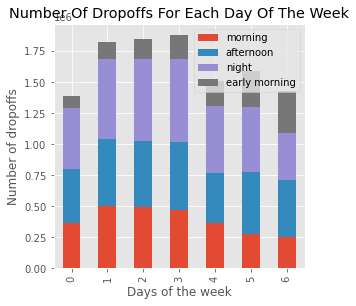

In [34]:
#finding number of dropoffs for each day of the week divided into timeslots
hour['tpep_dropoff_datetime'] = pd.to_datetime(hour['tpep_dropoff_datetime'])
hour["d_day"] = hour['tpep_dropoff_datetime'].dt.strftime('%u').astype(int)
hour["d_hour"] = hour['tpep_dropoff_datetime'].dt.strftime('%H').astype(int)
set(hour['d_day'].values)
day = []
afternoon = []
night = []
early = []
#day is [6,12), afternoon is [12,18), night is [18, 23), early morning is [23, 6)
for i in range(1,8):
    day.append(hour[(hour.p_day == i) & (hour.p_hour >= 6) & (hour.p_hour < 12)].shape[0])
    afternoon.append(hour[(hour.p_day == i) & (hour.p_hour >= 12) & (hour.p_hour < 18)].shape[0])
    night.append(hour[(hour.p_day == i) & (hour.p_hour >= 18) & (hour.p_hour <= 23)].shape[0])
    early.append(hour[(hour.p_day == i) & (hour.p_hour >= 0) & (hour.p_hour < 6)].shape[0])

days =pd.DataFrame({'morning':day, 'afternoon':afternoon, 'night':night, 'early morning':early})
days.plot(kind='bar', stacked=True,figsize=(4.5, 4.5))
plt.ylabel('Number of dropoffs')
plt.xlabel('Days of the week')
plt.tick_params(axis='both', which='minor')
plt.title('Number Of Dropoffs For Each Day Of The Week')
plt.plot()

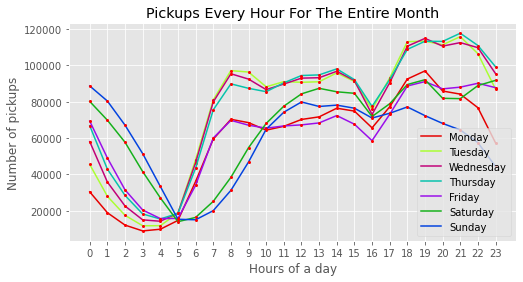

In [35]:
#pickups of every hour of the day for the entire month
hour_pickups = []
temp = []
for i in range(1,8):
    for j in range(0,24):
        temp.append(hour[(hour.p_day == i) & (hour.p_hour == j)].shape[0])
    hour_pickups.append(temp)
    temp = []
days = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']
colors = ['xkcd:red','xkcd:lime','xkcd:magenta','xkcd:turquoise','xkcd:violet','xkcd:green','xkcd:blue']

plt.figure(figsize=(8,4))
hours_lis = [lis for lis in range(0,24)]
for i in range(0,7):
    plt.plot(hours_lis,hour_pickups[i],colors[i],label = days[i])
    plt.plot(hours_lis,hour_pickups[i], 'ro',  markersize=2)

plt.xticks([lis for lis in range(0,24)])
plt.ylabel('Number of pickups')
plt.xlabel('Hours of a day')
plt.title('Pickups Every Hour For The Entire Month')
plt.legend()
plt.grid(True)
plt.show()

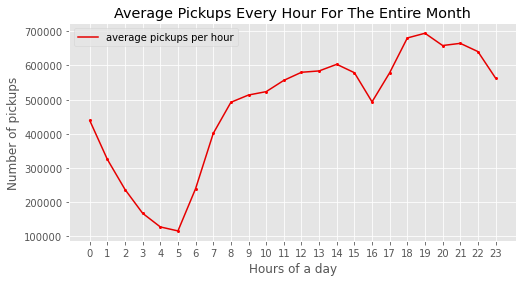

In [36]:
#averaging pickups for every hour
hour_pickup_month = []
for i in range(0,24):
    hour_pickup_month.append(hour[hour.p_hour == i].shape[0])

plt.figure(figsize=(8,4))
hours_lis = [lis for lis in range(0,24)]
plt.plot(hours_lis,hour_pickup_month,'xkcd:red',label = 'average pickups per hour')
plt.plot(hours_lis,hour_pickup_month, 'ro',  markersize=2)

plt.xticks([lis for lis in range(0,24)])
plt.ylabel('Number of pickups')
plt.xlabel('Hours of a day')
plt.title('Average Pickups Every Hour For The Entire Month')
plt.legend()
plt.grid(True)
plt.show()

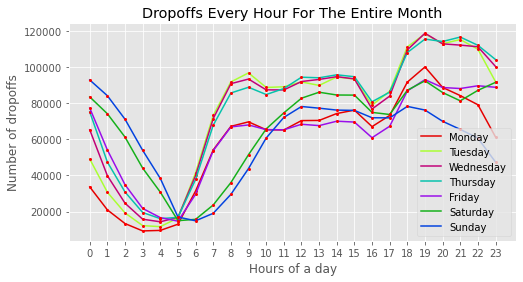

In [37]:
#dropoffs of every hour of the day for the entire monthhour_dropoffs = []
temp = []
for i in range(1,8):
    for j in range(0,24):
        temp.append(hour[(hour.d_day == i) & (hour.d_hour == j)].shape[0])
    hour_dropoffs.append(temp)
    temp = []
days = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']
colors = ['xkcd:red','xkcd:lime','xkcd:magenta','xkcd:turquoise','xkcd:violet','xkcd:green','xkcd:blue']

plt.figure(figsize=(8,4))
hours_lis = [lis for lis in range(0,24)]
for i in range(0,7):
    plt.plot(hours_lis,hour_dropoffs[i],colors[i],label = days[i])
    plt.plot(hours_lis,hour_dropoffs[i], 'ro',  markersize=2)

plt.xticks([lis for lis in range(0,24)])
plt.ylabel('Number of dropoffs')
plt.xlabel('Hours of a day')
plt.title('Dropoffs Every Hour For The Entire Month')
plt.legend()
plt.grid(True)
plt.show()

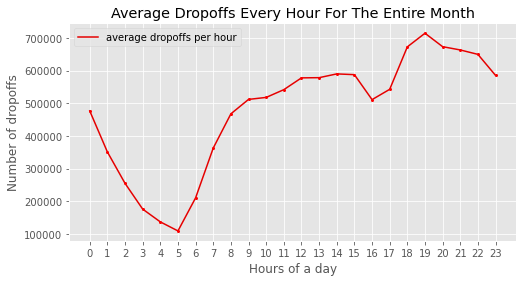

In [38]:
#averaging dropoffs for every hour
hour_dropoff_month = []
for i in range(0,24):
    hour_dropoff_month.append(hour[hour.d_hour == i].shape[0])

plt.figure(figsize=(8,4))
hours_lis = [lis for lis in range(0,24)]
plt.plot(hours_lis,hour_dropoff_month,'xkcd:red',label = 'average dropoffs per hour')
plt.plot(hours_lis,hour_dropoff_month, 'ro',  markersize=2)

plt.xticks([lis for lis in range(0,24)])
plt.ylabel('Number of dropoffs')
plt.xlabel('Hours of a day')
plt.title('Average Dropoffs Every Hour For The Entire Month')
plt.legend()
plt.grid(True)
plt.show()

In [17]:
coords = month_p[['pickup_latitude', 'pickup_longitude']].values
kmeans = MiniBatchKMeans(n_clusters=40).fit(coords)
month_p['pickup_cluster'] = kmeans.predict(month_p[['pickup_latitude', 'pickup_longitude']])

In [18]:
#kmeans clustering for pickup locations
cluster_centers = kmeans.cluster_centers_
cluster_len = len(cluster_centers)
map_osm = folium.Map(location=[40.734695, -73.990372], tiles='Stamen Terrain')
for i in range(cluster_len):
    folium.Marker(list((cluster_centers[i][0],cluster_centers[i][1])), popup=(str(cluster_centers[i][0])+str(cluster_centers[i][1]))).add_to(map_osm)
map_osm

In [19]:
coords = month_p[['dropoff_latitude', 'dropoff_longitude']].values
kmeans = MiniBatchKMeans(n_clusters=40).fit(coords)
month_p['dropoff_cluster'] = kmeans.predict(month_p[['dropoff_latitude', 'dropoff_longitude']])

In [20]:
#kmeans clustering for dropoff locations
cluster_centers = kmeans.cluster_centers_
cluster_len = len(cluster_centers)
map_osm = folium.Map(location=[40.734695, -73.990372], tiles='Stamen Terrain')
for i in range(cluster_len):
    folium.Marker(list((cluster_centers[i][0],cluster_centers[i][1])), popup=(str(cluster_centers[i][0])+str(cluster_centers[i][1]))).add_to(map_osm)
map_osm

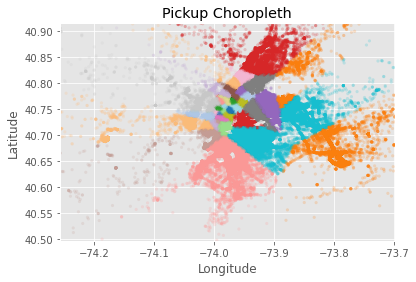

In [21]:
#pickup locations choropleth map with kmeans
city_long_border = (-74.257159, -73.699215)
city_lat_border = (40.495992, 40.915568)
fig, ax = plt.subplots(ncols=1, nrows=1)
ax.scatter(month_p.pickup_longitude.values, month_p.pickup_latitude.values, s=10, lw=0,
           c=month_p.pickup_cluster.values, cmap='tab20', alpha=0.2)
ax.set_xlim(city_long_border)
ax.set_ylim(city_lat_border)
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('Pickup Choropleth')
plt.show()

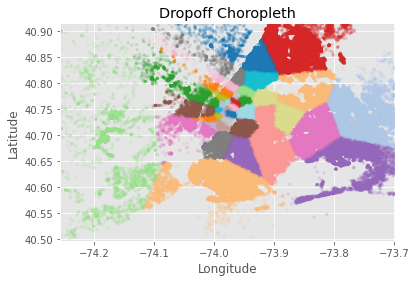

In [22]:
#dropoff locations choropleth map with kmeans
city_long_border = (-74.257159, -73.699215)
city_lat_border = (40.495992, 40.915568)
fig, ax = plt.subplots(ncols=1, nrows=1)
ax.scatter(month_p.dropoff_longitude.values, month_p.dropoff_latitude.values, s=10, lw=0,
           c=month_p.dropoff_cluster.values, cmap='tab20', alpha=0.2)
ax.set_xlim(city_long_border)
ax.set_ylim(city_lat_border)
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('Dropoff Choropleth')
plt.show()